In [211]:
%matplotlib inline

import pydicom                   
import os
import PIL.Image as Image
import math
import pylab
import numpy as np
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import dicom
import os
import scipy.ndimage
import matplotlib.pyplot as plt

from skimage import measure, morphology
from mpl_toolkits.mplot3d.art3d import Poly3DCollection

# Some constants 
INPUT_FOLDER = '/Users/sunjianxing/Artificial intelligence/Project/manifest-7qRRRBGo6029235898952856192/LungCT-Diagnosis/R_004/06-30-1997-Diagnostic Pre-Surgery Contrast Enhanced CT-71813/3.000000- NONE -29295'
#Lung-PET-CT-Dx/Lung_Dx-A0001/04-04-2007-Chest-07990/2.000000-5mm-40805/
#Artificial intelligence/Project/manifest-7qRRRBGo6029235898952856192/LungCT-Diagnosis/R_004/06-30-1997-Diagnostic Pre-Surgery Contrast Enhanced CT-71813/3.000000- NONE -29295          

patients = os.listdir(INPUT_FOLDER)
patients.sort()

print(patients)

['1-01.dcm', '1-02.dcm', '1-03.dcm', '1-04.dcm', '1-05.dcm', '1-06.dcm', '1-07.dcm', '1-08.dcm', '1-09.dcm', '1-10.dcm', '1-11.dcm', '1-12.dcm', '1-13.dcm', '1-14.dcm', '1-15.dcm', '1-16.dcm', '1-17.dcm', '1-18.dcm', '1-19.dcm', '1-20.dcm', '1-21.dcm', '1-22.dcm', '1-23.dcm', '1-24.dcm', '1-25.dcm', '1-26.dcm', '1-27.dcm', '1-28.dcm', '1-29.dcm', '1-30.dcm', '1-31.dcm', '1-32.dcm', '1-33.dcm', '1-34.dcm', '1-35.dcm', '1-36.dcm', '1-37.dcm', '1-38.dcm', '1-39.dcm', '1-40.dcm', '1-41.dcm', '1-42.dcm', '1-43.dcm', '1-44.dcm', '1-45.dcm', '1-46.dcm', '1-47.dcm', '1-48.dcm', '1-49.dcm', '1-50.dcm', '1-51.dcm', '1-52.dcm', '1-53.dcm', '1-54.dcm', '1-55.dcm', '1-56.dcm', '1-57.dcm', '1-58.dcm', '1-59.dcm', '1-60.dcm', '1-61.dcm', '1-62.dcm', '1-63.dcm', '1-64.dcm', '1-65.dcm', '1-66.dcm', '1-67.dcm', '1-68.dcm']


In [212]:
def load_scan(path):
    slices = [pydicom.read_file(path + '/' + s) for s in os.listdir(path)]
    slices.sort(key = lambda x: int(x.InstanceNumber))
    try:
        slice_thickness = np.abs(slices[0].ImagePositionPatient[2] - slices[1].ImagePositionPatient[2])
    except:
        slice_thickness = np.abs(slices[0].SliceLocation - slices[1].SliceLocation)
        
    for s in slices:
        s.SliceThickness = slice_thickness
        
    return slices

def get_pixels_hu(scans):
    image = np.stack([s.pixel_array for s in scans])
    # Convert to int16 (from sometimes int16), 
    # should be possible as values should always be low enough (<32k)
    image = image.astype(np.int16)

    # Set outside-of-scan pixels to 0
    # The intercept is usually -1024, so air is approximately 0
    image[image == -2000] = 0
    
    # Convert to Hounsfield units (HU)
    intercept = scans[0].RescaleIntercept
    slope = scans[0].RescaleSlope
    
    if slope != 1:
        image = slope * image.astype(np.float64)
        image = image.astype(np.int16)
        
    image += np.int16(intercept)
    
    return np.array(image, dtype=np.int16)

In [213]:
import pandas as pd
import os
'''def load_scan(path):#加载DICOM数据
    slices = [pydicom.read_file(path + '/' + s) for s in os.listdir(path)]
    return slices'''


collection = pd.read_csv('./manifest-7qRRRBGo6029235898952856192/metadata.csv')
#collection.to_numpy()
Location = collection['File Location']

x=0
for path in Location:
    patients = os.listdir('./manifest-7qRRRBGo6029235898952856192/'+ path)
    patients.sort()
    print(path)
    first_patient = load_scan('./manifest-7qRRRBGo6029235898952856192/' + path)
    print(len(first_patient))
    
    first_patient_pixels = get_pixels_hu(first_patient)
    '''plt.hist(first_patient_pixels.flatten(), bins=80, color='c')
    plt.xlabel("Hounsfield Units (HU)")
    plt.ylabel("Frequency")
    plt.show()'''
    if(x==1):
        break
    x+=1
    


./LungCT-Diagnosis/R_004/06-30-1997-Diagnostic Pre-Surgery Contrast Enhanced CT-71813/3.000000- NONE -29295
68
./LungCT-Diagnosis/R_013/02-09-1997-Diagnostic Pre-Surgery Contrast Enhanced CT-74850/2.000000- NONE -86053
67


In [214]:
first_patient[0].SliceThickness
first_patient[0].PixelSpacing
print(first_patient)

[Dataset.file_meta -------------------------------
(0002, 0000) File Meta Information Group Length  UL: 194
(0002, 0001) File Meta Information Version       OB: b'\x00\x01'
(0002, 0002) Media Storage SOP Class UID         UI: CT Image Storage
(0002, 0003) Media Storage SOP Instance UID      UI: 1.3.6.1.4.1.14519.5.2.1.4320.5030.167081480874127921723715738850
(0002, 0010) Transfer Syntax UID                 UI: Implicit VR Little Endian
(0002, 0012) Implementation Class UID            UI: 1.2.40.0.13.1.1.1
(0002, 0013) Implementation Version Name         SH: 'dcm4che-1.4.34'
-------------------------------------------------
(0008, 0005) Specific Character Set              CS: 'ISO_IR 100'
(0008, 0008) Image Type                          CS: ['ORIGINAL', 'PRIMARY', 'AXIAL', 'CT_SOM5 SPI']
(0008, 0016) SOP Class UID                       UI: CT Image Storage
(0008, 0018) SOP Instance UID                    UI: 1.3.6.1.4.1.14519.5.2.1.4320.5030.167081480874127921723715738850
(0008, 0020) S

In [215]:
import cv2
print(first_patient_pixels.shape)

def normalization(image):
    return (image - image.min())/(image.max() - image.min())
def _resize_image(image, target):
    return cv2.resize(image, dsize=(target[0], target[1]), interpolation=cv2.INTER_LINEAR)

patient_pixels = normalization(first_patient_pixels)

target_shape = (256,256)
image = [_resize_image(image=i, target=target_shape) for i in patient_pixels]
patient_pixels = np.stack(image, axis=0)
patient_pixels = np.reshape(patient_pixels,(len(first_patient),256,256,1))
print(patient_pixels.max())
patients = np.zeros((len(first_patient),256,256,3))
for i in range(patient_pixels.shape[0]):
    image = patient_pixels[i]
    image = image.astype('float32')
    image = cv2.cvtColor(image, cv2.COLOR_GRAY2BGR)
    patients[i] = image
print(patients.shape)



(67, 512, 512)
1.0
(67, 256, 256, 3)


In [216]:
from tensorflow.keras.utils import get_custom_objects
import tensorflow as tf

def get_segmentation_model():
    
    class FixedDropout(tf.keras.layers.Dropout):
        def _get_noise_shape(self, inputs):
            if self.noise_shape is None:
                return self.noise_shape

            symbolic_shape = tf.keras.backend.shape(inputs)
            noise_shape = [symbolic_shape[axis] if shape is None else shape
                           for axis, shape in enumerate(self.noise_shape)]
            return tuple(noise_shape)

    def DiceCoef(y_trues, y_preds, smooth=1e-5, axis=None):
        intersection = tf.reduce_sum(y_trues * y_preds, axis=axis)
        union = tf.reduce_sum(y_trues, axis=axis) + tf.reduce_sum(y_preds, axis=axis)
        return tf.reduce_mean((2*intersection+smooth) / (union + smooth))

    def DiceLoss(y_trues, y_preds):
        return 1.0 - DiceCoef(y_trues, y_preds)

    get_custom_objects().update({'swish': tf.keras.layers.Activation(tf.nn.swish)})
    get_custom_objects().update({'FixedDropout':FixedDropout})
    get_custom_objects().update({'DiceCoef' : DiceCoef})
    get_custom_objects().update({'DiceLoss' : DiceLoss})
    
    print('Load segmentation model...')
    model = tf.keras.models.load_model('./lung-ct-segmentation-pretrain/osic_segmentation_model.h5')
    return model
    
def resample(image, scan, new_spacing=[1,1,1]):
    # Determine current pixel spacing
    spacing = np.array([scan[0].SliceThickness] + [x for x in scan[0].PixelSpacing], dtype=np.float32)
    resize_factor = spacing / new_spacing
    new_real_shape = image.shape * resize_factor
    new_shape = np.round(new_real_shape)
    real_resize_factor = new_shape / image.shape
    new_spacing = spacing / real_resize_factor
    
    image = scipy.ndimage.interpolation.zoom(image, real_resize_factor, mode='nearest')
    
    return image, new_spacing

model = get_segmentation_model()

Load segmentation model...


In [217]:
pred_masks = model.predict(patients, verbose=0)
pred_masks = (pred_masks>0.5).astype(np.float32)
print(pred_masks.shape)

(67, 256, 256, 1)


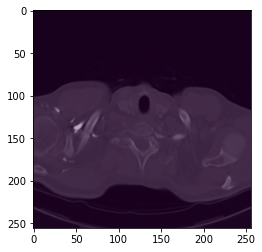

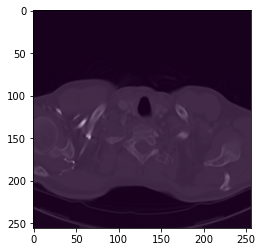

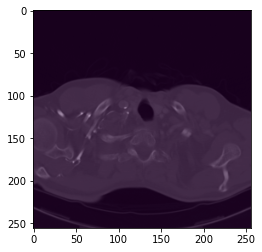

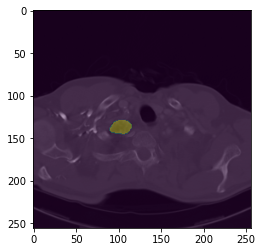

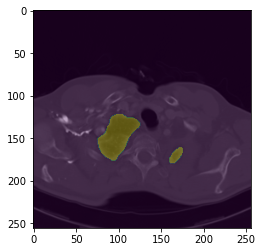

...

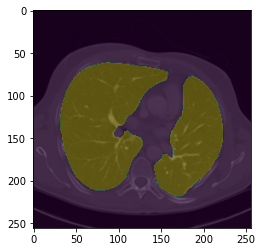

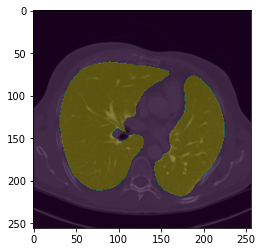

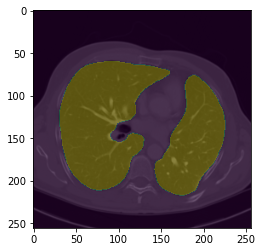

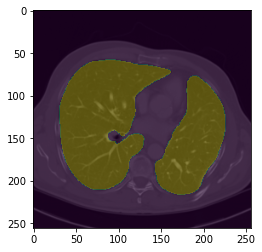

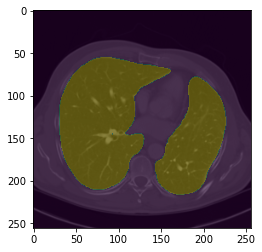

In [218]:
for i in range(30):
    plt.imshow(patients[i])
    plt.imshow(pred_masks[i,:,:,0],alpha=0.35)
    plt.show()
    

In [219]:
def make_gradcam_heatmap(img_array, model, last_conv_layer_name, pred_index=None):
    grad_model = tf.keras.models.Model(
        [model.inputs], [model.get_layer(last_conv_layer_name).output, model.output]
    )
    with tf.GradientTape() as tape:
        last_conv_layer_output, preds = grad_model(img_array)
        if pred_index is None:
            pred_index = tf.argmax(preds[0])
        class_channel = preds[:, pred_index]

    grads = tape.gradient(class_channel, last_conv_layer_output)
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))
    last_conv_layer_output = last_conv_layer_output[0]
    heatmap = last_conv_layer_output @ pooled_grads[..., tf.newaxis]
    heatmap = tf.squeeze(heatmap)
    heatmap = tf.maximum(heatmap, 0) / tf.math.reduce_max(heatmap)
    return heatmap.numpy()

def normalization(image):
    return (image - image.min())/(image.max()+0.000001 - image.min())

def gray_to_redblue(image):
    R,G,B = image[:,:,0], image[:,:,1], image[:,:,2]
    #grey = sum(pixel) // len(pixel)
    redvalue = 1 - R  # "darkness"
    bluevalue = B  # "brightness"
    image[:,:,0] = B
    image[:,:,1] = 0
    image[:,:,2] = 1-R
    return image# + alpha


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(14, 14)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


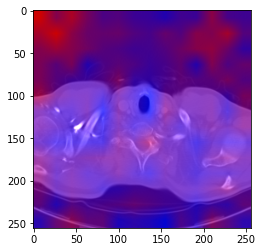

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(14, 14)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


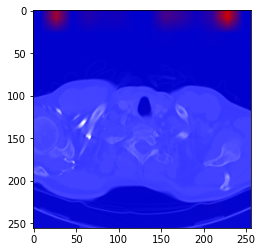

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(14, 14)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


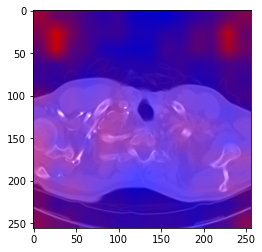

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(14, 14)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


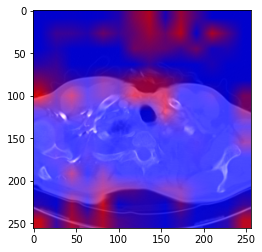

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(14, 14)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


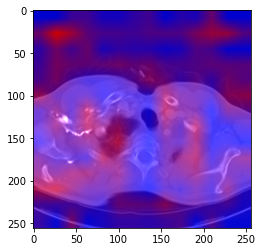

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(14, 14)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


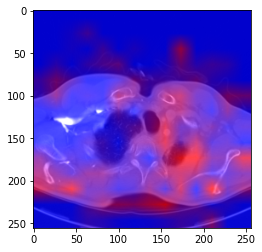

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(14, 14)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


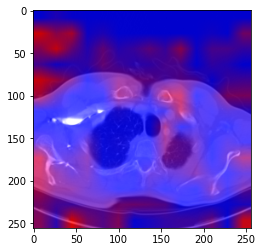

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(14, 14)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


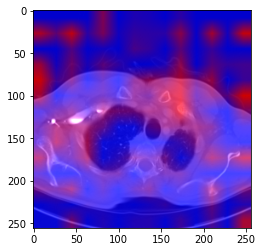

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(14, 14)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


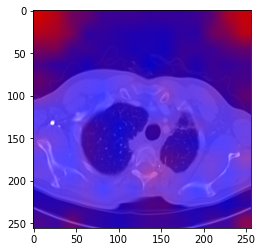

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(14, 14)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


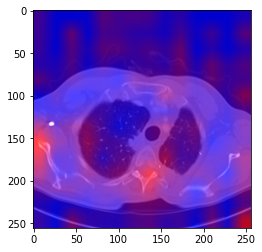

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(14, 14)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


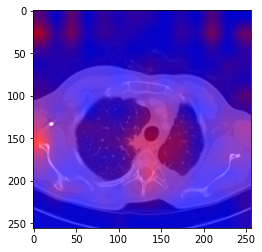

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(14, 14)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


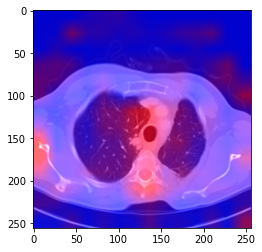

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(14, 14)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


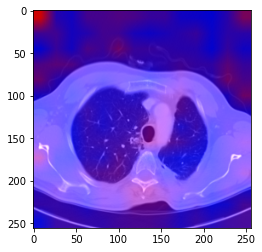

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(14, 14)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


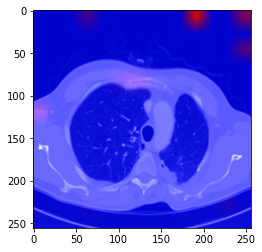

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(14, 14)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


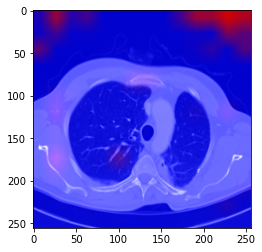

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(14, 14)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


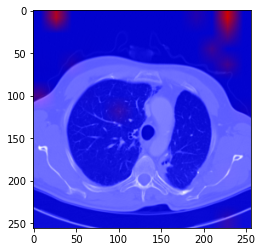

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(14, 14)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


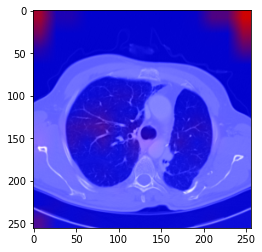

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(14, 14)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


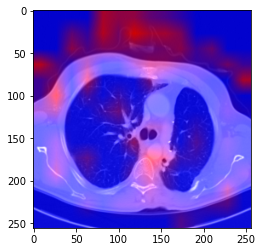

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(14, 14)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


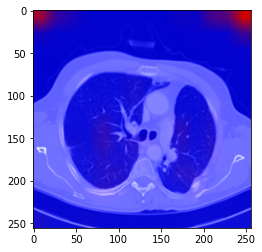

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(14, 14)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


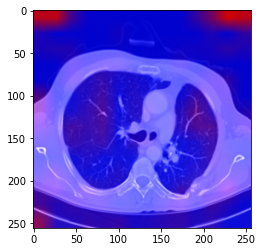

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(14, 14)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


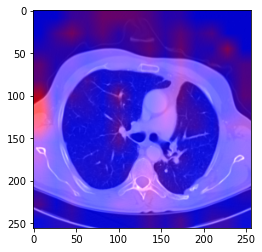

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(14, 14)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


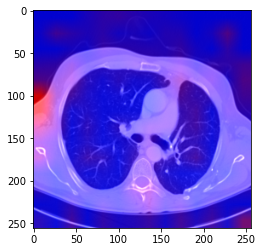

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(14, 14)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


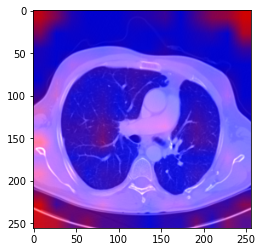

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(14, 14)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


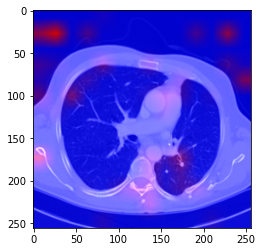

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(14, 14)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


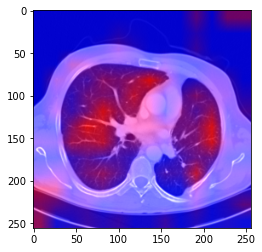

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(14, 14)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


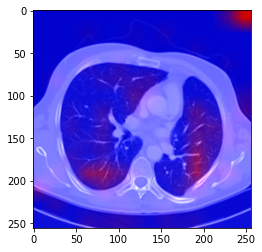

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(14, 14)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


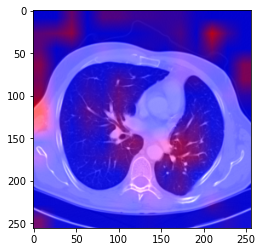

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(14, 14)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


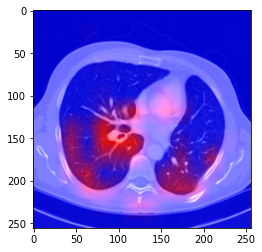

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(14, 14)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


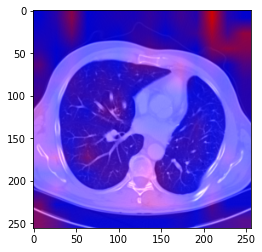

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(14, 14)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


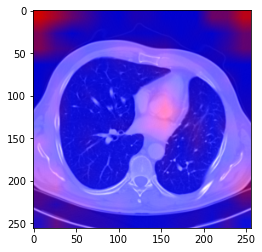

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(14, 14)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


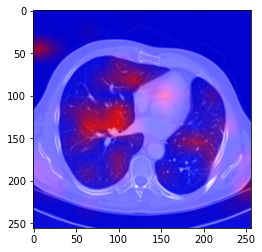

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(14, 14)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


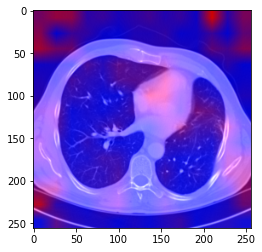

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(14, 14)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


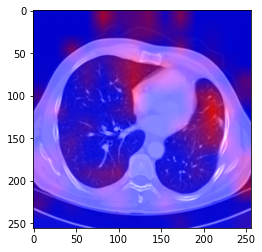

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(14, 14)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


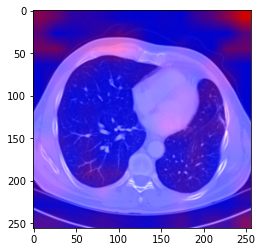

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(14, 14)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


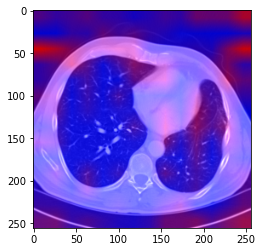

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(14, 14)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


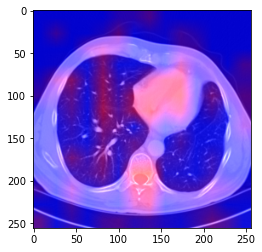

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(14, 14)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


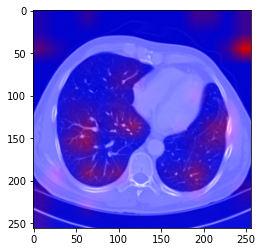

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(14, 14)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


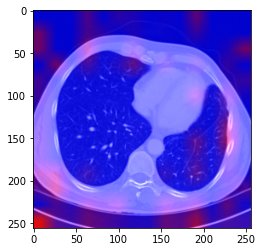

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(14, 14)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


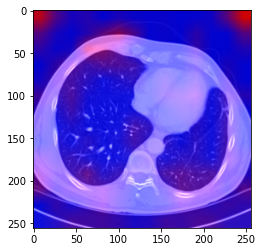

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(14, 14)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


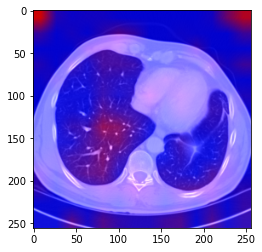

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(14, 14)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


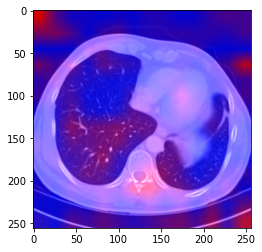

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(14, 14)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


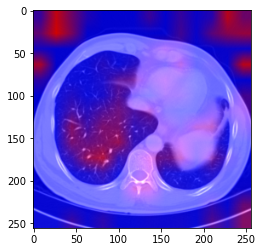

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(14, 14)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


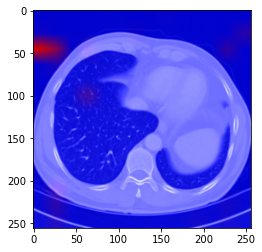

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(14, 14)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


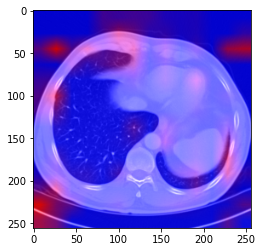

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(14, 14)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


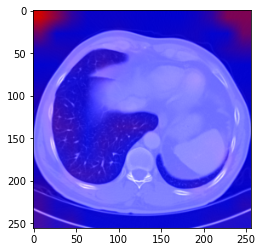

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(14, 14)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


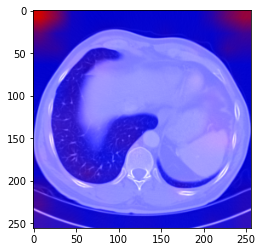

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(14, 14)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


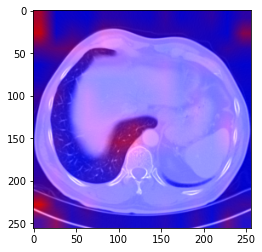

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(14, 14)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


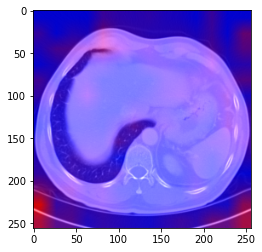

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(14, 14)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


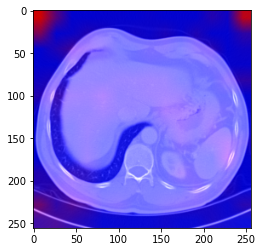

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(14, 14)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


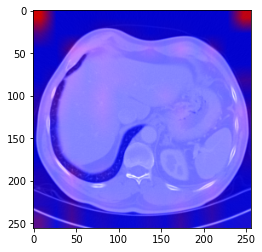

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(14, 14)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


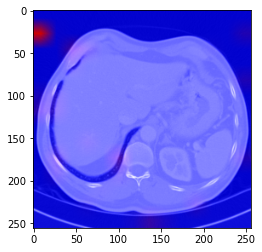

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(14, 14)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


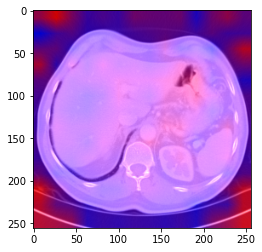

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(14, 14)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


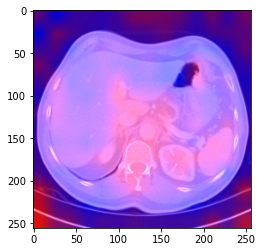

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(14, 14)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


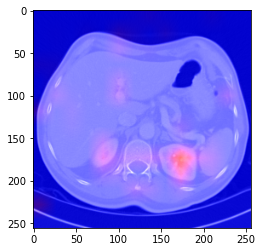

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(14, 14)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


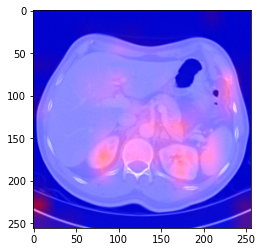

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(14, 14)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


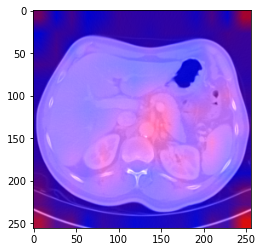

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(14, 14)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


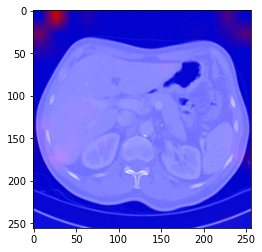

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(14, 14)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


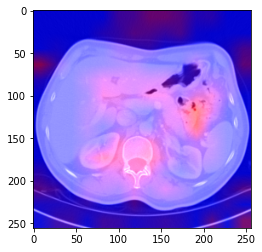

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(14, 14)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


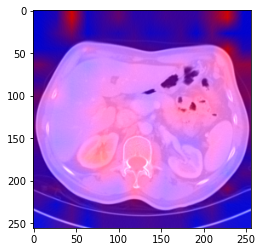

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(14, 14)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


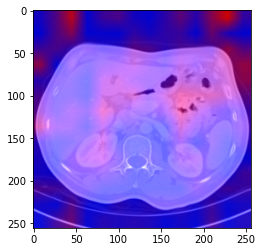

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(14, 14)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


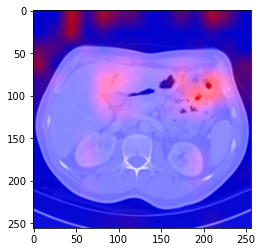

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(14, 14)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


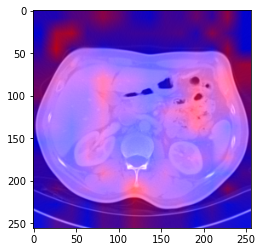

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(14, 14)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


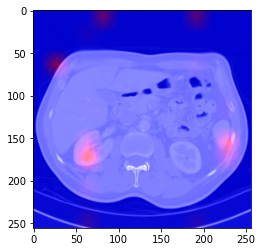

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(14, 14)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


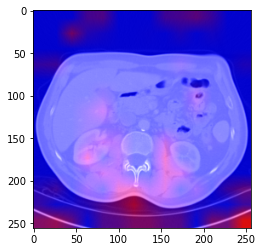

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(14, 14)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


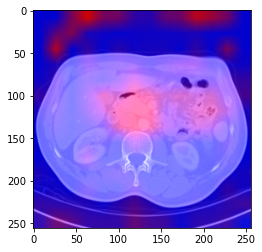

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(14, 14)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


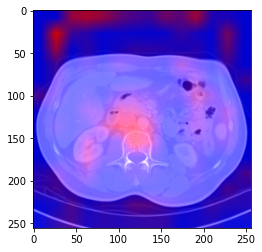

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(14, 14)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


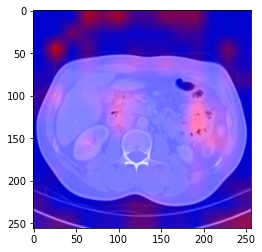

In [220]:
import cv2
from PIL import Image
from sklearn import preprocessing
import pylab
from tensorflow import keras
import numpy as np
import tensorflow as tf

np.isfinite(patients).all()
def generate_CAM(image,layer):
    img_array = np.reshape(image,(1,image.shape[0],image.shape[1],image.shape[2]))
    preds = model.predict(img_array)
    H5py_cam = make_gradcam_heatmap(img_array,model,layer)
    print(H5py_cam.shape)
    heatmap = cv2.resize(H5py_cam,(image.shape[0],image.shape[1]))
    print(img_array.shape)
    img_map = np.reshape(img_array,(image.shape[0],image.shape[1],image.shape[2]))
    heatmap = normalization(heatmap)
    img_map = normalization(img_map)
    heatmap = cv2.cvtColor(heatmap,cv2.COLOR_GRAY2RGB)
    #img_map = cv2.cvtColor(img_map,cv2.COLOR_GRAY2RGB)
    heatmap = gray_to_redblue(heatmap)
    #heatmap = cv2.cvtColor(heatmap,cv2.COLOR_GRAY2RGB)
    print(heatmap.shape)
    print(img_map.shape)
    combination = heatmap * 0.8 + img_map * 1

    plt.imshow(combination)
    plt.show()
    
    return heatmap
    #pylab.imshow(img_map, cmap=pylab.cm.gray)  
    #pylab.show()
    #pylab.imshow(heatmap, cmap=pylab.cm.jet)  
    #pylab.show()

model = keras.models.load_model('./model_Inceptionv3.h5')

heatmap1 = np.zeros(patients.shape)
for i in range(len(patients)):
    heatmap1[i] = generate_CAM(patients[i],'mixed7')
    

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(6, 6)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


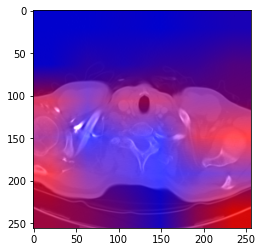

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(6, 6)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


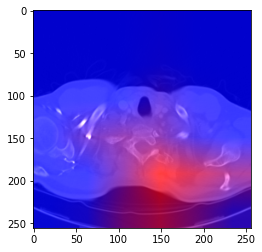

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(6, 6)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


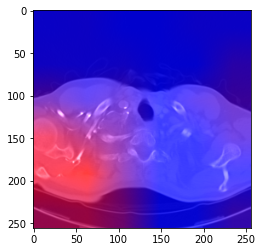

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(6, 6)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


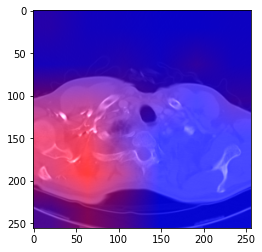

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(6, 6)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


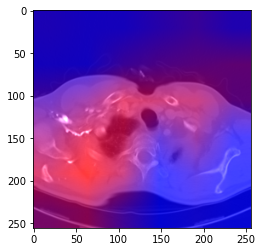

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(6, 6)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


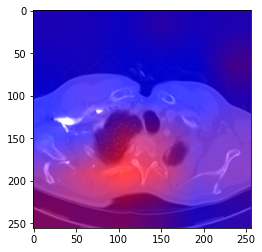

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(6, 6)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


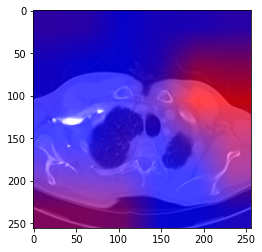

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(6, 6)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


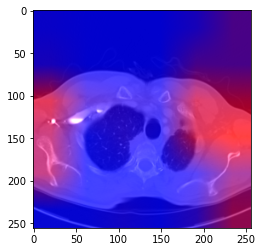

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(6, 6)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


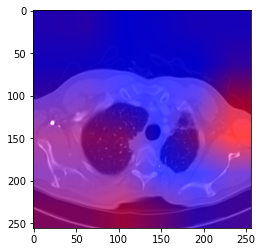

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(6, 6)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


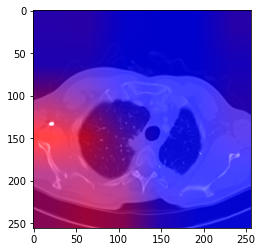

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(6, 6)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


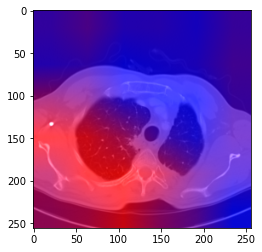

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(6, 6)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


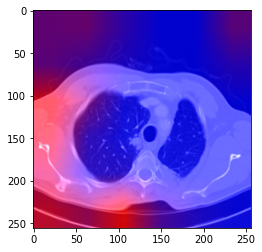

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(6, 6)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


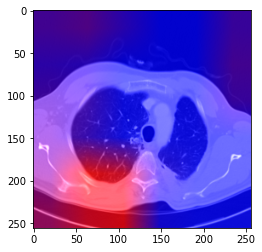

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(6, 6)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


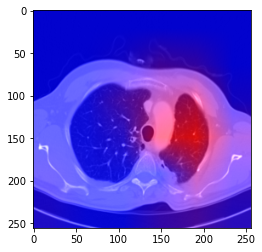

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(6, 6)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


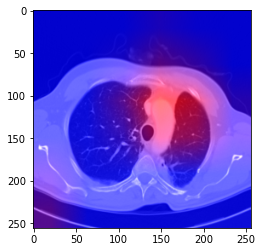

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(6, 6)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


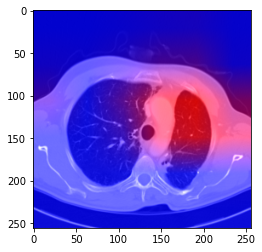

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(6, 6)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


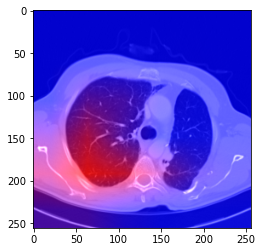

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(6, 6)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


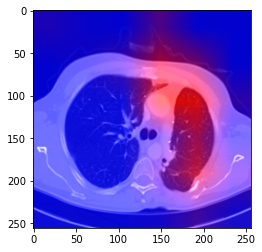

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(6, 6)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


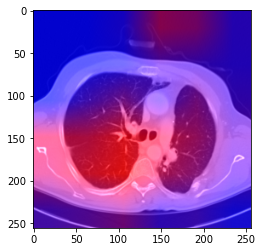

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(6, 6)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


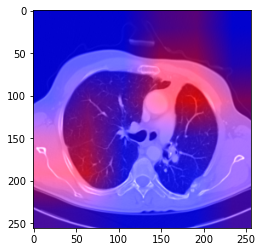

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(6, 6)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


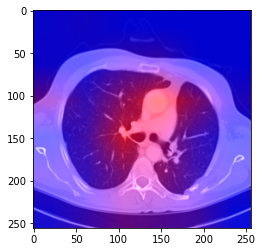

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(6, 6)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


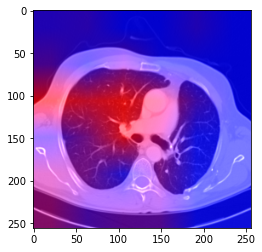

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(6, 6)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


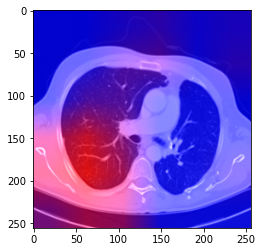

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(6, 6)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


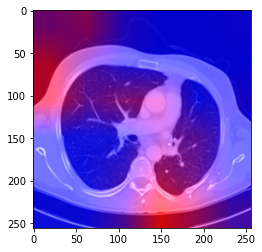

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(6, 6)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


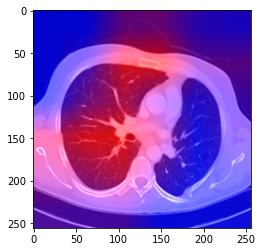

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(6, 6)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


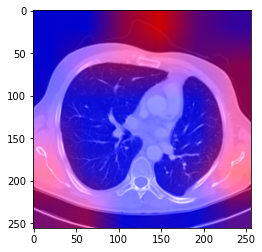

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(6, 6)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


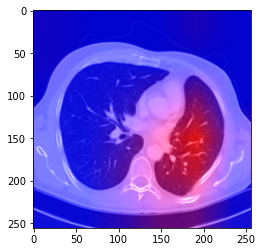

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(6, 6)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


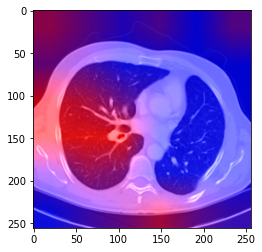

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(6, 6)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


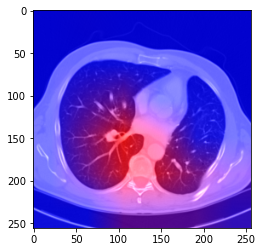

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(6, 6)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


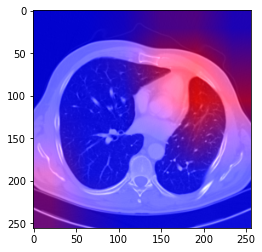

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(6, 6)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


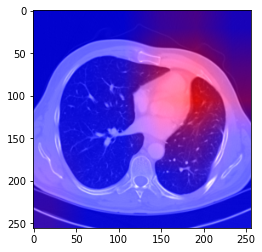

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(6, 6)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


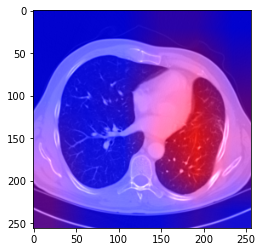

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(6, 6)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


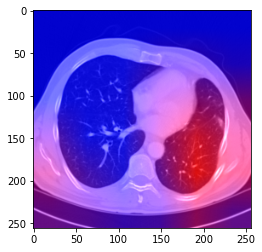

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(6, 6)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


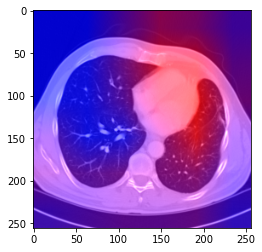

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(6, 6)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


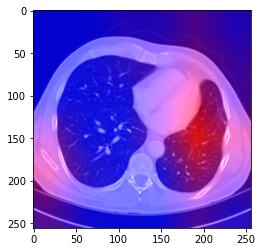

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(6, 6)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


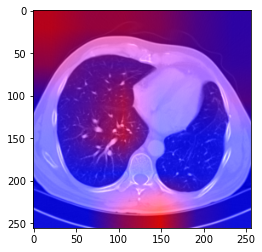

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(6, 6)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


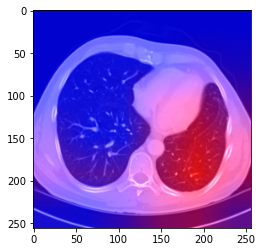

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(6, 6)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


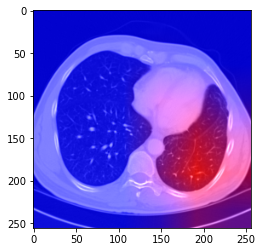

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(6, 6)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


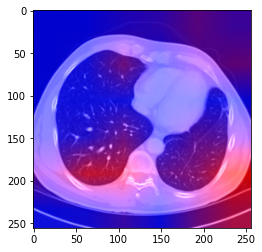

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(6, 6)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


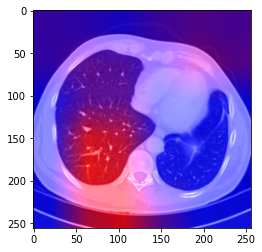

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(6, 6)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


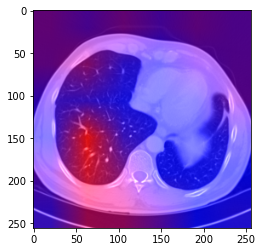

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(6, 6)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


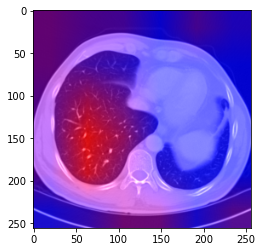

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(6, 6)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


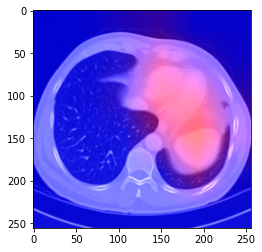

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(6, 6)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


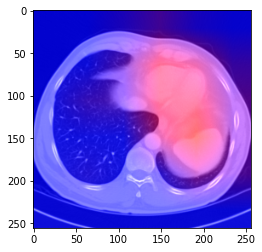

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(6, 6)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


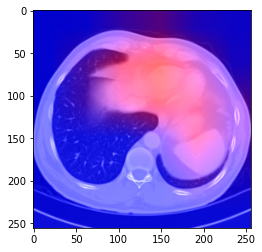

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(6, 6)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


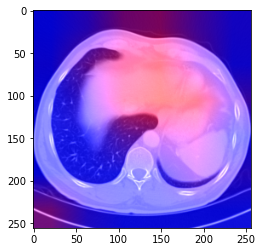

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(6, 6)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


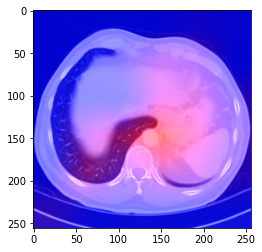

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(6, 6)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


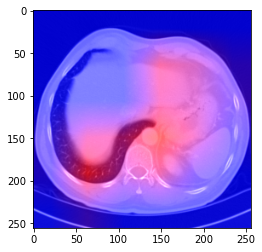

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(6, 6)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


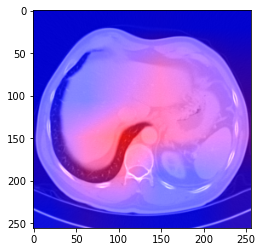

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(6, 6)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


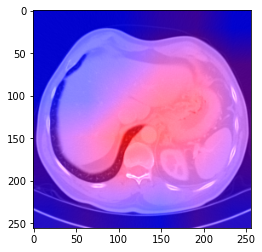

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(6, 6)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


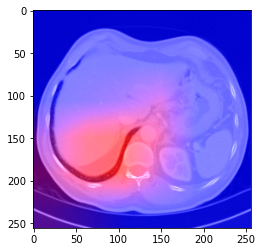

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(6, 6)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


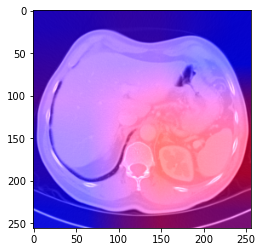

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(6, 6)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


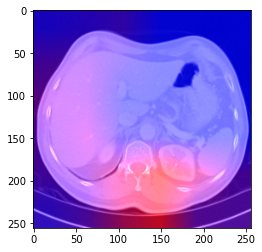

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(6, 6)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


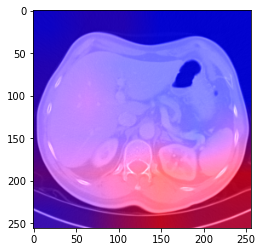

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(6, 6)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


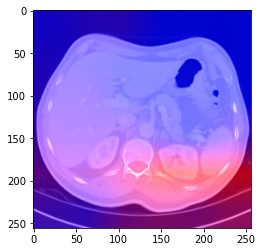

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(6, 6)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


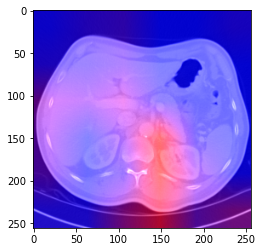

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(6, 6)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


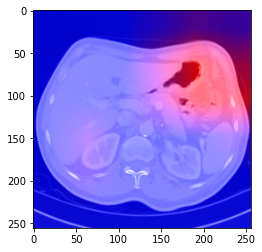

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(6, 6)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


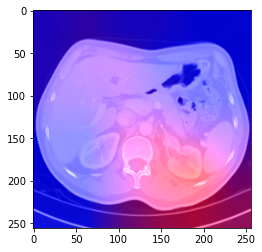

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(6, 6)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


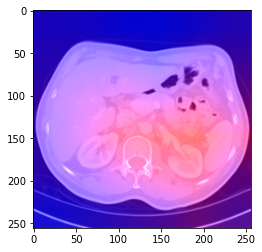

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(6, 6)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


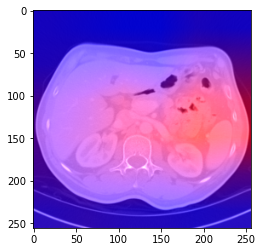

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(6, 6)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


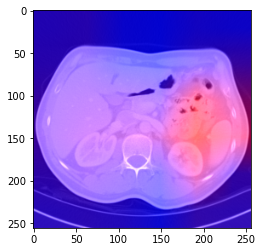

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(6, 6)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


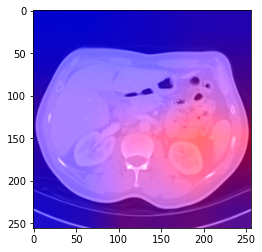

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(6, 6)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


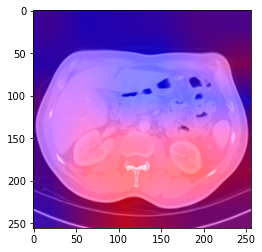

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(6, 6)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


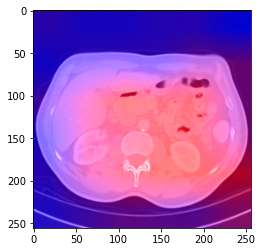

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(6, 6)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


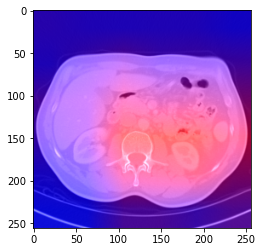

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(6, 6)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


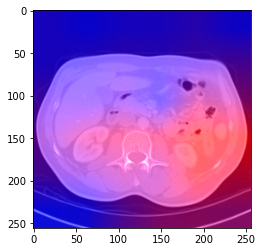

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(6, 6)
(1, 256, 256, 3)
(256, 256, 3)
(256, 256, 3)


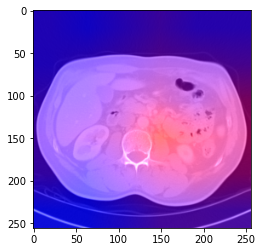

In [221]:
model = keras.models.load_model('./model_Inceptionv3.h5')

heatmap2 = np.zeros(patients.shape)
for i in range(len(patients)):
    heatmap2[i] = generate_CAM(patients[i],'mixed10')

[1. 0. 0. 0.]


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


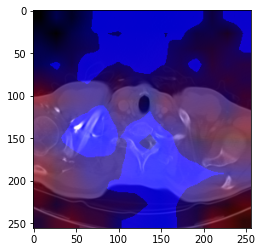

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[1. 0. 0. 0.]


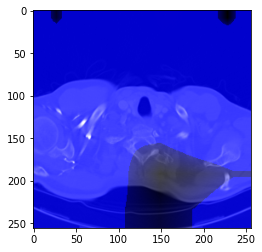

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[1. 0. 0. 0.]


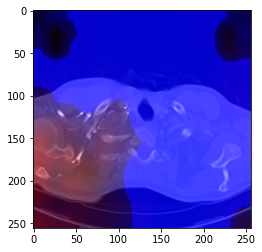

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[1. 0. 0. 0.]


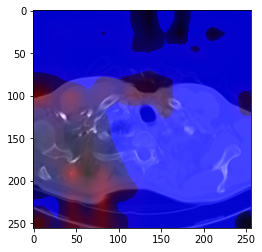

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[1. 0. 0. 0.]


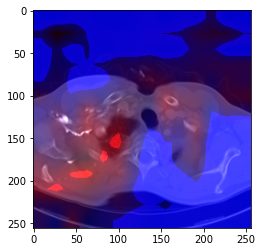

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[1. 0. 0. 0.]


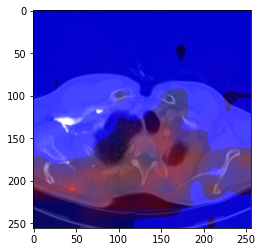

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[1. 0. 0. 0.]


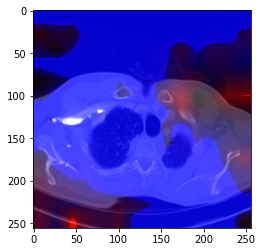

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[1. 0. 0. 0.]


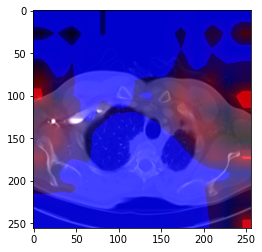

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[1. 0. 0. 0.]


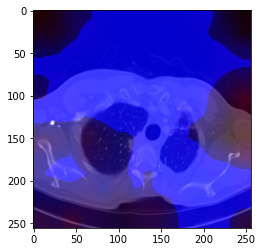

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[1. 0. 0. 0.]


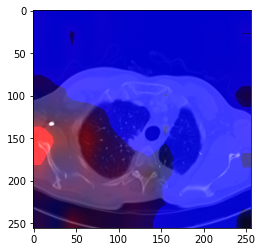

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[1. 0. 0. 0.]


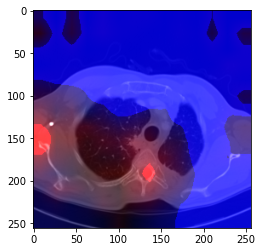

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[1. 0. 0. 0.]


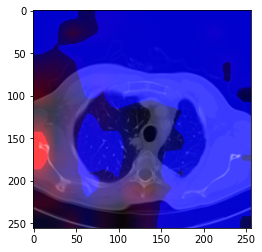

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[0. 0. 1. 0.]


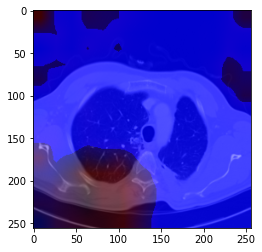

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[0. 0. 1. 0.]


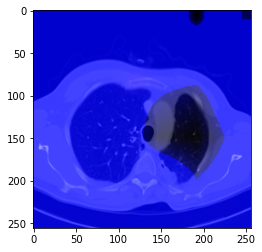

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[1. 0. 0. 0.]


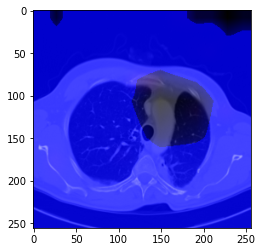

[0. 1. 0. 0.]


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


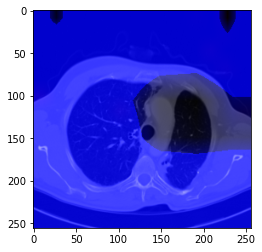

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[0. 1. 0. 0.]


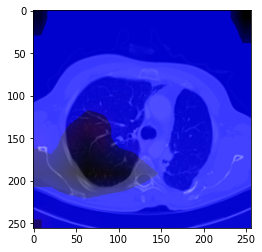

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[1. 0. 0. 0.]


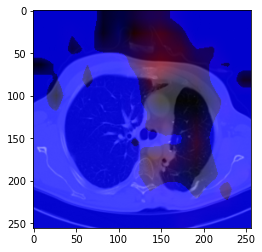

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[0. 0. 1. 0.]


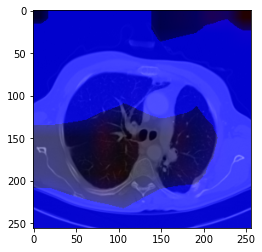

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[0. 0. 1. 0.]


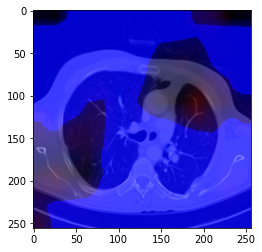

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[0. 0. 1. 0.]


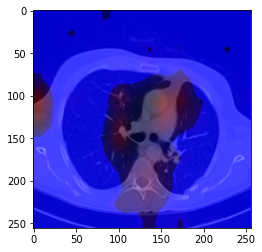

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[0. 0. 0. 0.]


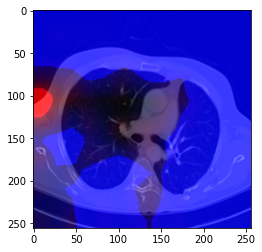

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[1. 0. 0. 0.]


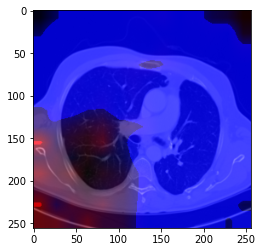

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[1. 0. 0. 0.]


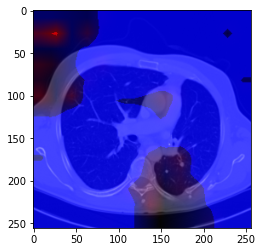

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[1. 0. 0. 0.]


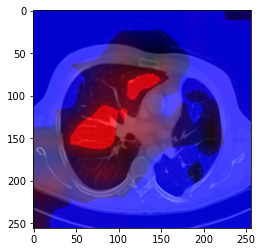

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[1. 0. 0. 0.]


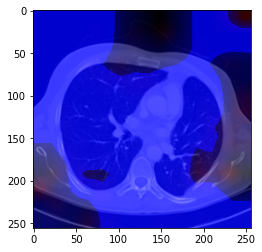

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[0. 1. 0. 0.]


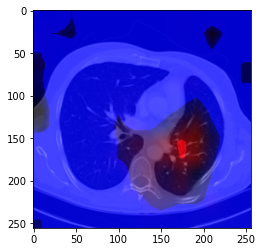

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[1. 0. 0. 0.]


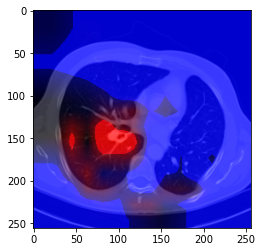

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[1. 0. 0. 0.]


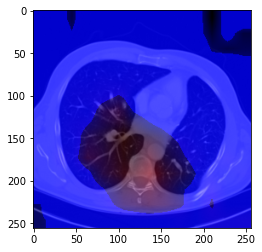

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[1. 0. 0. 0.]


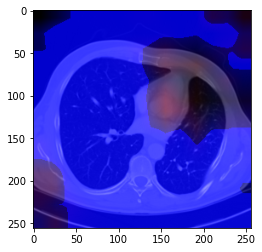

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[1. 0. 0. 0.]


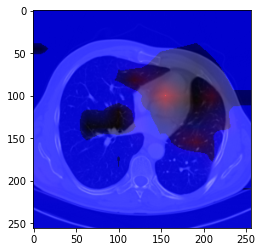

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[1. 0. 0. 0.]


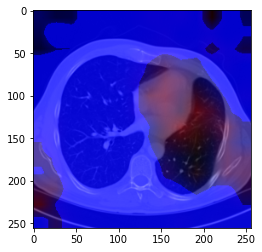

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[1. 0. 0. 0.]


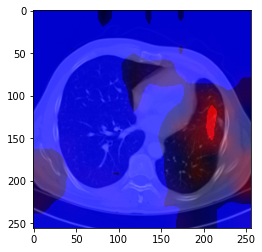

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[1. 0. 0. 0.]


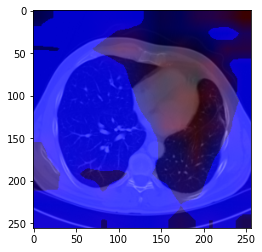

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[1. 0. 0. 0.]


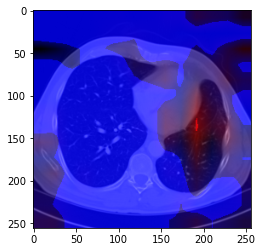

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[1. 0. 0. 0.]


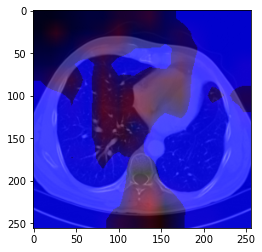

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[1. 0. 0. 0.]


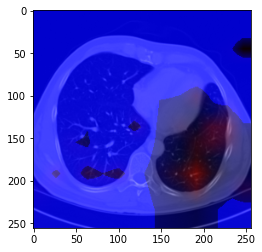

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[1. 0. 0. 0.]


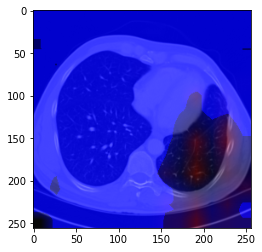

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[1. 0. 0. 0.]


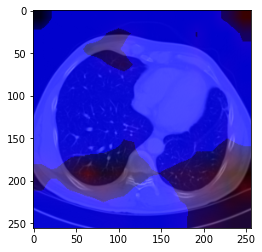

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[1. 0. 0. 0.]


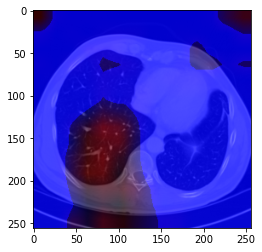

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[1. 0. 0. 0.]


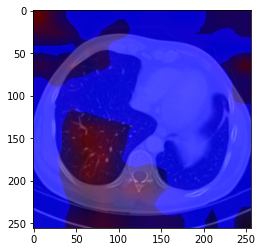

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[1. 0. 0. 0.]


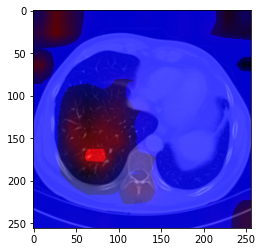

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[1. 0. 0. 0.]


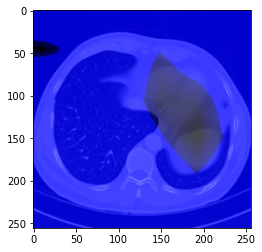

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[0. 0. 1. 0.]


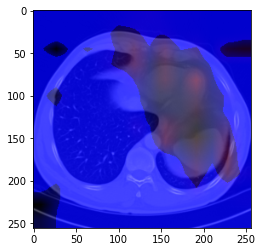

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[1. 0. 0. 0.]


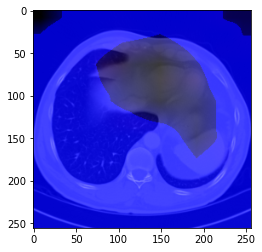

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[0. 0. 1. 0.]


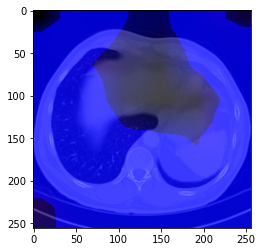

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[0. 0. 1. 0.]


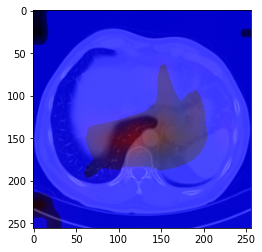

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[0. 0. 1. 0.]


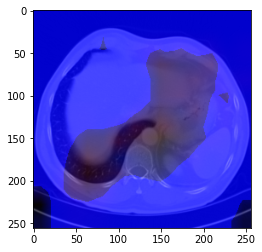

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[0. 0. 1. 0.]


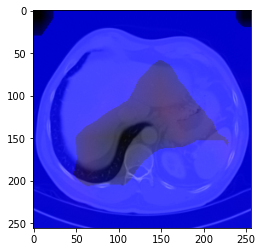

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[0. 0. 1. 0.]


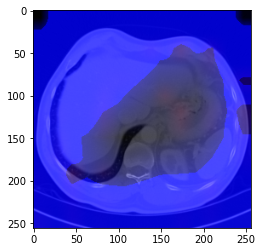

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[0. 0. 1. 0.]


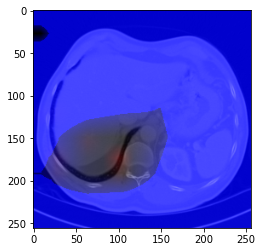

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[0. 0. 1. 0.]


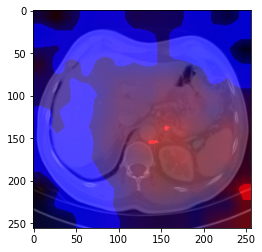

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[0. 0. 1. 0.]


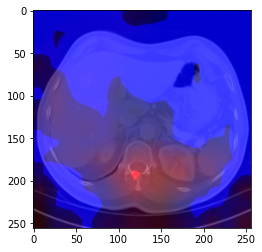

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[0. 0. 1. 0.]


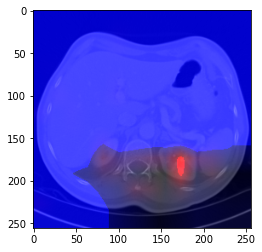

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[0. 0. 1. 0.]


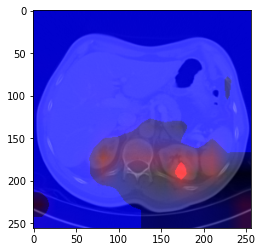

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[1. 0. 0. 0.]


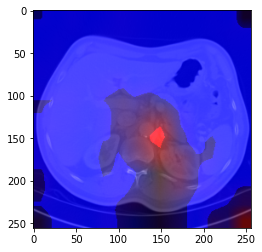

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[1. 0. 0. 0.]


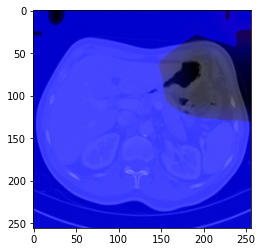

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[0. 0. 1. 0.]


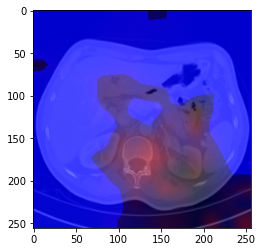

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[1. 0. 0. 0.]


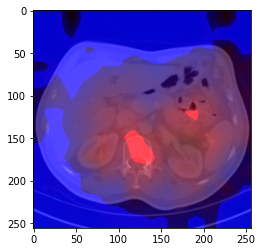

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[1. 0. 0. 0.]


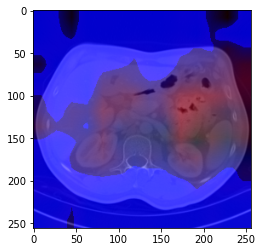

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[1. 0. 0. 0.]


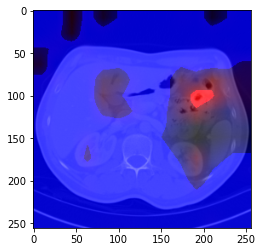

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[0. 0. 1. 0.]


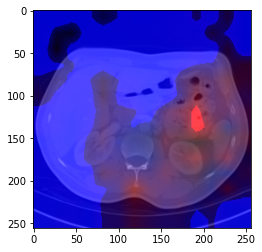

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[1. 0. 0. 0.]


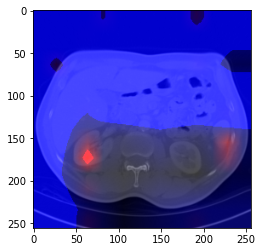

[1. 0. 0. 0.]


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


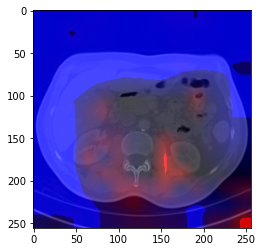

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[1. 0. 0. 0.]


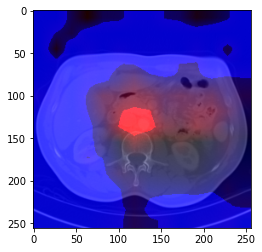

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[1. 0. 0. 0.]


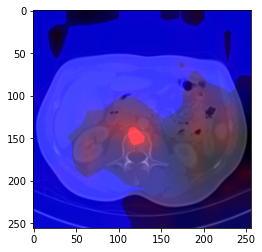

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[1. 0. 0. 0.]


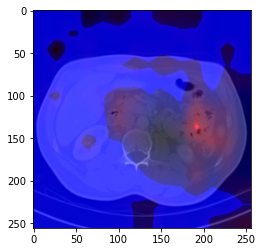

In [222]:
import numpy as geek
index=0
heatmap = np.zeros(patients.shape)
for i in range(len(patients)):
    heatmap[i] = geek.multiply(heatmap1[i],heatmap2[i])
    index = heatmap > 0.5
    heatmap[index]=1
    combination = heatmap[i] * 0.8 + patients[i] * 1
    print(pred[i])
    plt.imshow(combination)
    plt.show()

In [223]:
print(heatmap[:,:,:,0].max())

1.0


In [224]:
model = keras.models.load_model('./model_Inceptionv3.h5')
pred = model.predict(patients)
pred = (pred>0.5).astype(np.float32)

available = np.zeros(len(patients))
for i in range(pred_masks.shape[0]):
    print(pred_masks[i].sum())
    available[i] = pred_masks[i].sum()
print(pred)
indices=[]

for i in range(pred.shape[0]):
    #if(pred[i,2]>0.5):
    if(available[i]>1000):
        indices.append(i)
print(indices)
predict = pred[indices].sum(axis=0)
print(predict)

0.0
0.0
0.0
339.0
1773.0
3207.0
4392.0
5579.0
6858.0
7995.0
9081.0
10180.0
11303.0
12163.0
13056.0
13858.0
14517.0
15243.0
15760.0
16734.0
17233.0
17409.0
17624.0
17863.0
18241.0
18649.0
18838.0
18832.0
19157.0
19501.0
19476.0
19421.0
19315.0
19385.0
19423.0
19547.0
19599.0
19576.0
19462.0
19385.0
18147.0
16556.0
15131.0
13796.0
12159.0
10031.0
7514.0
5419.0
3733.0
2348.0
1284.0
496.0
97.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
[[1. 0. 0. 0.]
 [0. 1. 0. 0.]
 [1. 0. 0. 0.]
 [1. 0. 0. 0.]
 [1. 0. 0. 0.]
 [1. 0. 0. 0.]
 [1. 0. 0. 0.]
 [1. 0. 0. 0.]
 [1. 0. 0. 0.]
 [1. 0. 0. 0.]
 [1. 0. 0. 0.]
 [1. 0. 0. 0.]
 [1. 0. 0. 0.]
 [0. 1. 0. 0.]
 [0. 1. 0. 0.]
 [0. 1. 0. 0.]
 [0. 0. 1. 0.]
 [0. 1. 0. 0.]
 [0. 0. 1. 0.]
 [0. 0. 1. 0.]
 [0. 1. 0. 0.]
 [0. 1. 0. 0.]
 [0. 0. 1. 0.]
 [1. 0. 0. 0.]
 [0. 0. 1. 0.]
 [0. 0. 1. 0.]
 [0. 1. 0. 0.]
 [0. 0. 0. 0.]
 [0. 1. 0. 0.]
 [0. 0. 1. 0.]
 [0. 0. 1. 0.]
 [0. 0. 1. 0.]
 [0. 0. 1. 0.]
 [0. 0. 1. 0.]
 [0. 0. 1. 0.]
 [1. 0. 0. 0.]
 [0. 0. 1. 

(67, 4)
[[[4.49081231e-01 0.00000000e+00 5.25396672e-07]
  [4.49081231e-01 0.00000000e+00 5.25396672e-07]
  [4.49081231e-01 0.00000000e+00 5.25396672e-07]
  ...
  [1.06365773e-01 0.00000000e+00 4.51721661e-01]
  [1.06365773e-01 0.00000000e+00 4.51721661e-01]
  [1.06365773e-01 0.00000000e+00 4.51721661e-01]]

 [[4.49081231e-01 0.00000000e+00 5.25396672e-07]
  [4.49081231e-01 0.00000000e+00 5.25396672e-07]
  [4.49081231e-01 0.00000000e+00 5.25396672e-07]
  ...
  [1.06365773e-01 0.00000000e+00 4.51721661e-01]
  [1.06365773e-01 0.00000000e+00 4.51721661e-01]
  [1.06365773e-01 0.00000000e+00 4.51721661e-01]]

 [[4.49081231e-01 0.00000000e+00 5.25396672e-07]
  [4.49081231e-01 0.00000000e+00 5.25396672e-07]
  [4.49081231e-01 0.00000000e+00 5.25396672e-07]
  ...
  [1.06365773e-01 0.00000000e+00 4.51721661e-01]
  [1.06365773e-01 0.00000000e+00 4.51721661e-01]
  [1.06365773e-01 0.00000000e+00 4.51721661e-01]]

 ...

 [[2.32153318e-02 0.00000000e+00 1.00000000e+00]
  [2.32153318e-02 0.00000000e+0

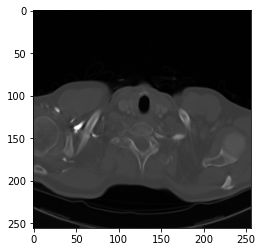

[0. 1. 0. 0.]


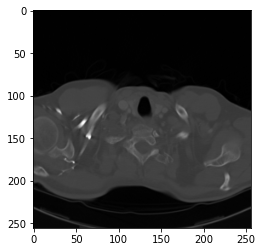

[1. 0. 0. 0.]


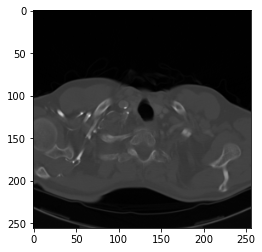

[1. 0. 0. 0.]


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


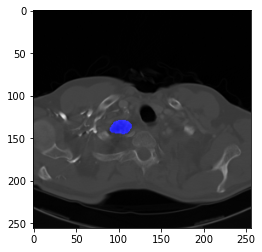

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[1. 0. 0. 0.]


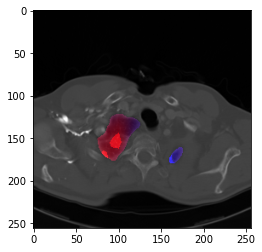

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[1. 0. 0. 0.]


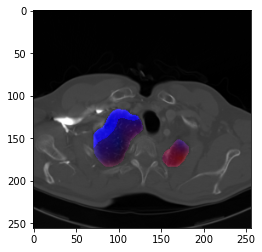

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[1. 0. 0. 0.]


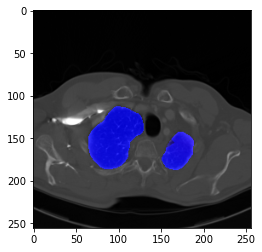

[1. 0. 0. 0.]


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


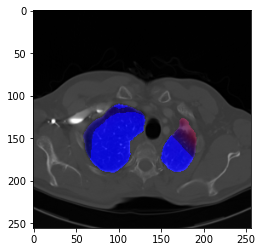

[1. 0. 0. 0.]


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


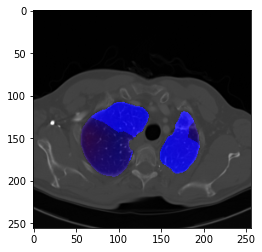

[1. 0. 0. 0.]


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


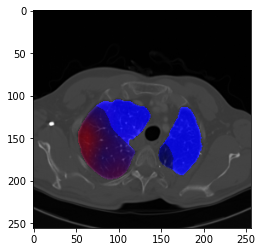

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[1. 0. 0. 0.]


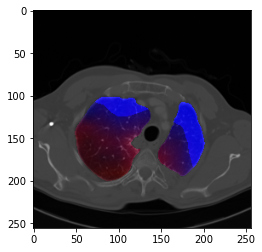

[1. 0. 0. 0.]


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


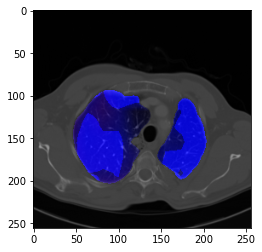

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[1. 0. 0. 0.]


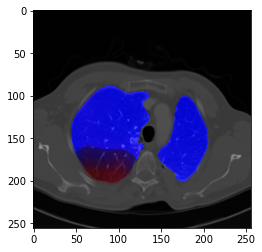

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[0. 1. 0. 0.]


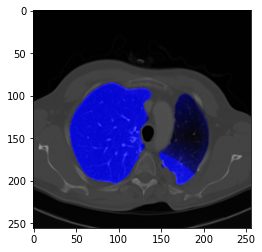

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[0. 1. 0. 0.]


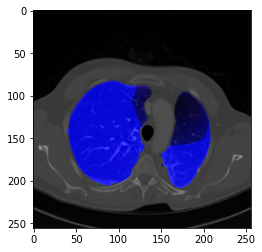

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[0. 1. 0. 0.]


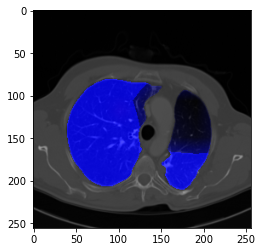

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[0. 0. 1. 0.]


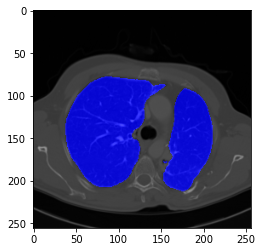

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[0. 1. 0. 0.]


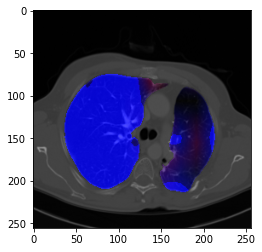

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[0. 0. 1. 0.]


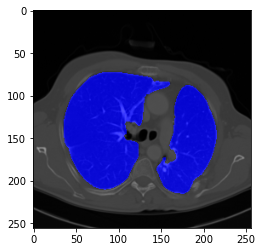

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[0. 0. 1. 0.]


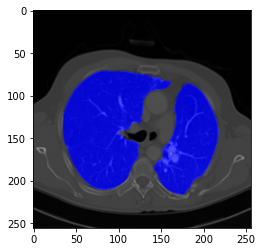

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[0. 1. 0. 0.]


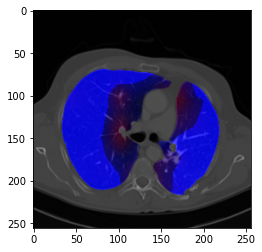

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[0. 1. 0. 0.]


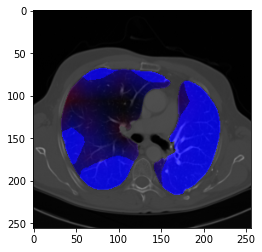

[0. 0. 1. 0.]


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


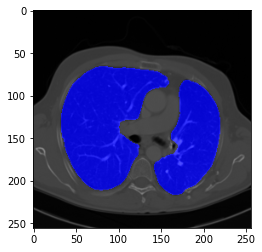

[1. 0. 0. 0.]


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


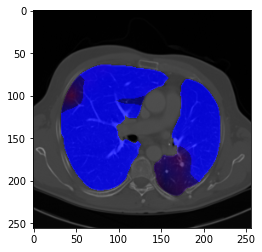

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[0. 0. 1. 0.]


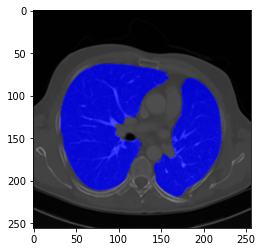

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[0. 0. 1. 0.]


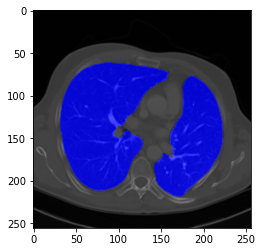

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[0. 1. 0. 0.]


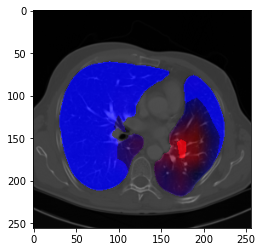

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[0. 0. 0. 0.]


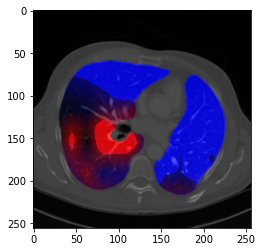

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[0. 1. 0. 0.]


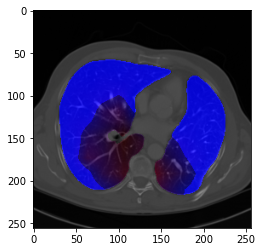

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[0. 0. 1. 0.]


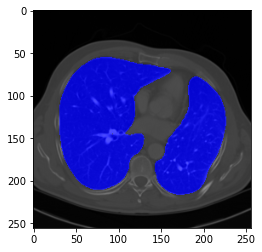

[0. 0. 1. 0.]


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


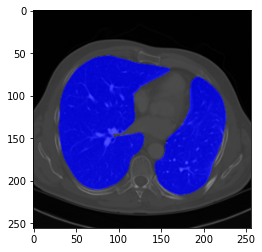

[0. 0. 1. 0.]


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


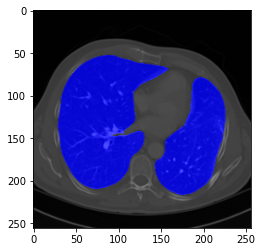

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[0. 0. 1. 0.]


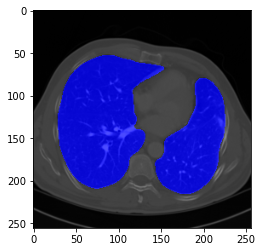

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[0. 0. 1. 0.]


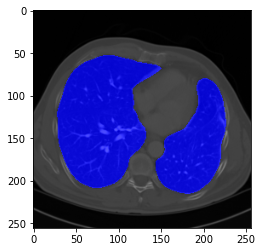

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[0. 0. 1. 0.]


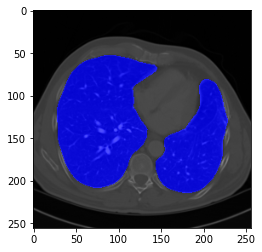

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[1. 0. 0. 0.]


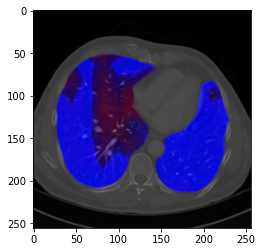

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[0. 0. 1. 0.]


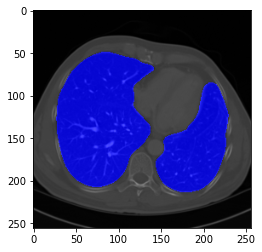

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[0. 0. 1. 0.]


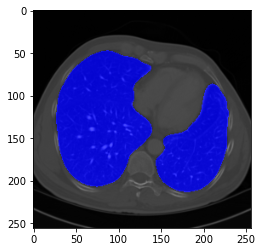

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[0. 0. 1. 0.]


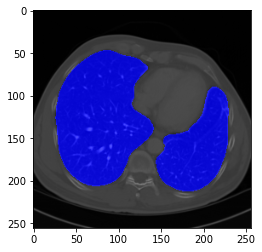

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[1. 0. 0. 0.]


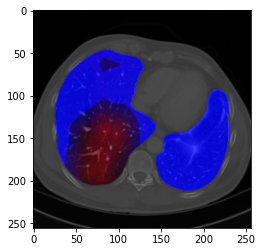

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[1. 0. 0. 0.]


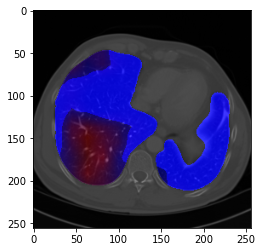

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[1. 0. 0. 0.]


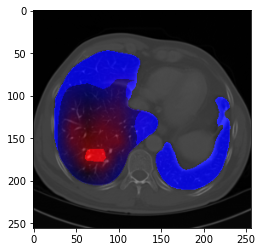

[0. 0. 1. 0.]


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


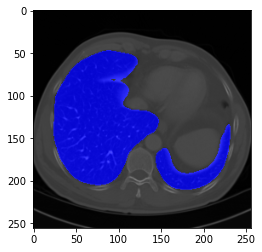

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[0. 0. 1. 0.]


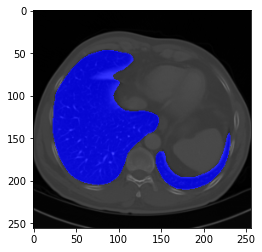

[0. 0. 1. 0.]


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


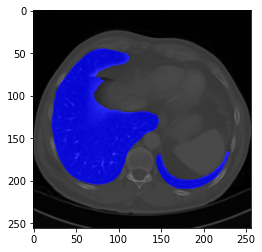

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[0. 0. 1. 0.]


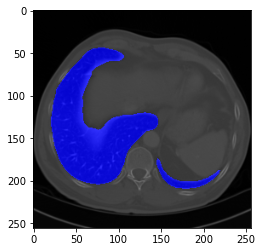

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[0. 0. 1. 0.]


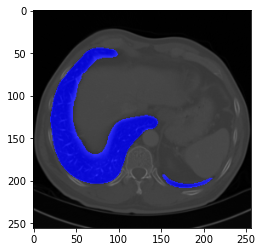

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[0. 0. 1. 0.]


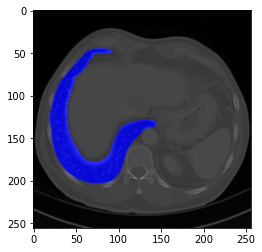

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[0. 0. 1. 0.]


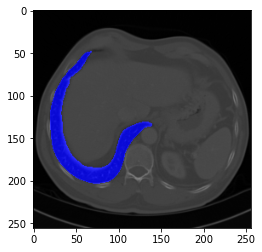

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[0. 0. 1. 0.]


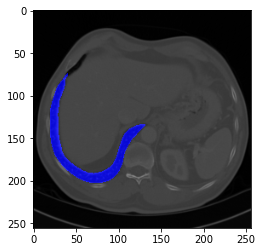

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[0. 0. 1. 0.]


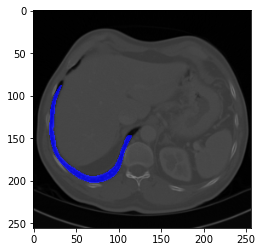

[1. 0. 0. 0.]


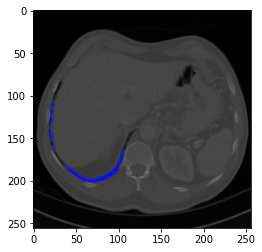

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[1. 0. 0. 0.]


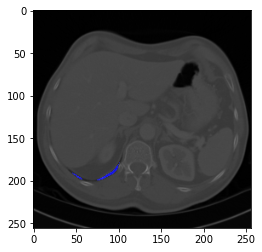

[1. 0. 0. 0.]


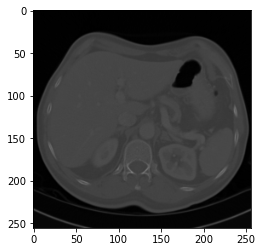

[1. 0. 0. 0.]


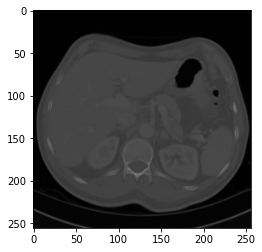

[1. 0. 0. 0.]


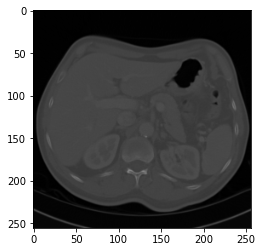

[0. 0. 1. 0.]


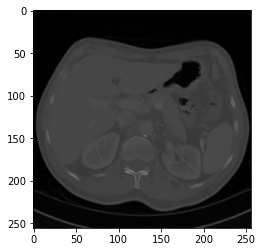

[1. 0. 0. 0.]


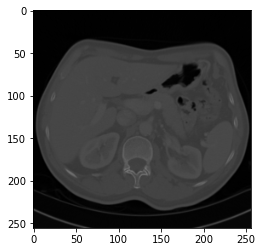

[1. 0. 0. 0.]


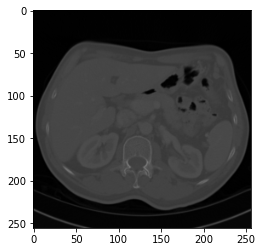

[1. 0. 0. 0.]


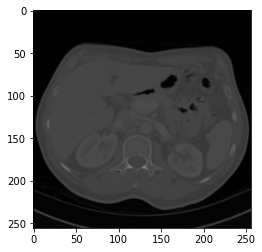

[1. 0. 0. 0.]


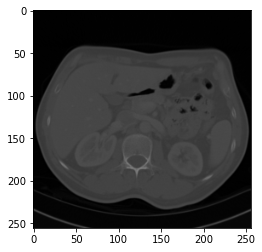

[1. 0. 0. 0.]


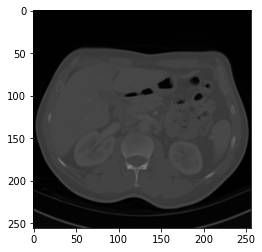

[1. 0. 0. 0.]


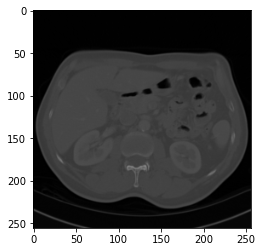

[1. 0. 0. 0.]


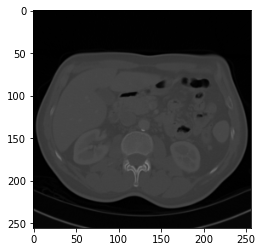

[1. 0. 0. 0.]


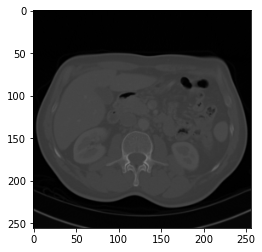

[1. 0. 0. 0.]


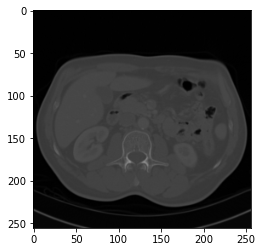

[1. 0. 0. 0.]


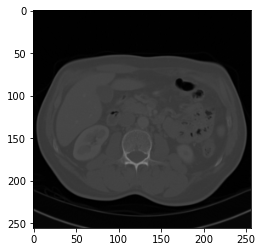

In [225]:
import numpy as geek
print(pred.shape)
for i in range(len(patients)):
    if(pred[i,2]>0.5 or pred_masks[i].sum()<1000):
        heatmap[i,:,:,0]=0
        heatmap[i,:,:,1]=0
        heatmap[i,:,:,2]=1
print(heatmap[40])
CTimages_located = geek.multiply(heatmap, pred_masks)


for i in range(len(CTimages_located)):
    
    combination = CTimages_located[i] * 0.8 + patients[i] * 1
    print(pred[i])
    plt.imshow(combination)
    plt.show()


In [226]:
print(CTimages_located[:,:,:,0].max())

1.0


(67, 256, 256, 3)
[5.        0.6230469 0.6230469]
-1.823954335440827e-18
(335, 160, 160)


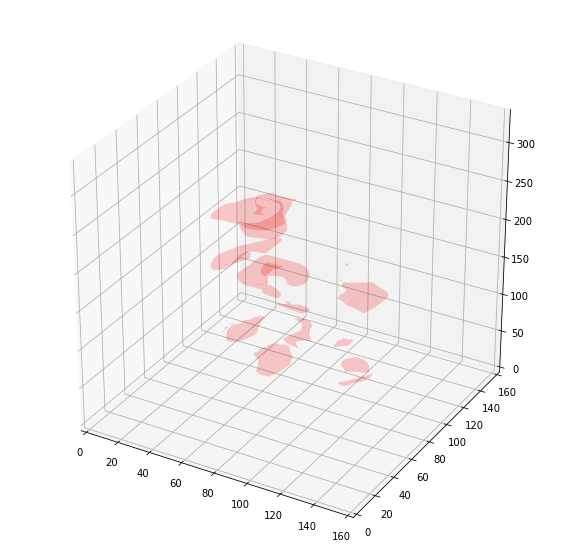

In [227]:
def resample(image, scan, new_spacing=[1,1,1]):
    # Determine current pixel spacing
    spacing = np.array([scan[0].SliceThickness] + list(scan[0].PixelSpacing), dtype=np.float32)
    print(spacing)
    resize_factor = spacing / new_spacing
    new_shape = np.round(image.shape * resize_factor)
    # recompute the resize factor and spacing such that we match the rounded new shape above
    rounded_resize_factor = new_shape / image.shape
    rounded_new_spacing = spacing / rounded_resize_factor
    # zoom with resize factor
    image = scipy.ndimage.interpolation.zoom(image, rounded_resize_factor, mode='nearest')
    return image, rounded_new_spacing

def plot_3d(image, threshold=700, color="red"):
    # Position the scan upright, 
    # so the head of the patient would be at the top facing the camera
    p = image.transpose(2,1,0)
    verts, faces,_,_ = measure.marching_cubes_lewiner(p, threshold)
    fig = plt.figure(figsize=(10, 10))
    ax = fig.add_subplot(111, projection='3d')
    # Fancy indexing: `verts[faces]` to generate a collection of triangles
    mesh = Poly3DCollection(verts[faces], alpha=0.1)
    mesh.set_facecolor(color)
    ax.add_collection3d(mesh)
    ax.set_xlim(0, p.shape[0])
    ax.set_ylim(0, p.shape[1])
    ax.set_zlim(0, p.shape[2])
    plt.savefig('./images/p4 predict', dpi=300)
    plt.show()
    
print(CTimages_located.shape)
CT = np.reshape(CTimages_located[:,:,:,0],(len(patients),256,256))

img_resampled, spacing = resample(CT, first_patient, [1,1,1])
print(img_resampled[0].min())
print(img_resampled.shape)
plot_3d(img_resampled,threshold=0.3)

In [228]:
def largest_label_volume(im, bg=-1):
    vals, counts = np.unique(im, return_counts=True)

    counts = counts[vals != bg]
    vals = vals[vals != bg]

    if len(counts) > 0:
        return vals[np.argmax(counts)]
    else:
        return None

def segment_lung_mask(image, fill_lung_structures=True):
    
    # not actually binary, but 1 and 2. 
    # 0 is treated as background, which we do not want
    binary_image = np.array(image > -320, dtype=np.int8)+1
    labels = measure.label(binary_image)
    
    # Pick the pixel in the very corner to determine which label is air.
    #   Improvement: Pick multiple background labels from around the patient
    #   More resistant to "trays" on which the patient lays cutting the air 
    #   around the person in half
    background_label = labels[0,0,0]
        
    #Fill the air around the person
    binary_image[background_label == labels] = 2
    
    # Method of filling the lung structures (that is superior to something like 
    # morphological closing)
    if fill_lung_structures:
        # For every slice we determine the largest solid structure
        for i, axial_slice in enumerate(binary_image):
            axial_slice = axial_slice - 1
            labeling = measure.label(axial_slice)
            l_max = largest_label_volume(labeling, bg=0)
            
            if l_max is not None: #This slice contains some lung
                binary_image[i][labeling != l_max] = 1

    
    binary_image -= 1 #Make the image actual binary
    binary_image = 1-binary_image # Invert it, lungs are now 1
    
    # Remove other air pockets insided body
    labels = measure.label(binary_image, background=0)
    l_max = largest_label_volume(labels, bg=0)
    if l_max is not None: # There are air pockets
        binary_image[labels != l_max] = 0
 
    return binary_image

In [187]:
def plot_3d_(image, threshold=700, color="blue"):
    
    # Position the scan upright, 
    # so the head of the patient would be at the top facing the camera
    p = image.transpose(2,1,0)
    
    verts, faces,_,_ = measure.marching_cubes_lewiner(p, threshold)

    fig = plt.figure(figsize=(10, 10))
    ax = fig.add_subplot(111, projection='3d')

    # Fancy indexing: `verts[faces]` to generate a collection of triangles
    mesh = Poly3DCollection(verts[faces], alpha=0.1)
    mesh.set_facecolor(color)
    ax.add_collection3d(mesh)

    ax.set_xlim(0, p.shape[0])
    ax.set_ylim(0, p.shape[1])
    ax.set_zlim(0, p.shape[2])
    plt.savefig('./images/p4 tissue', dpi=300)

    plt.show()

[4.         0.66015625 0.66015625]


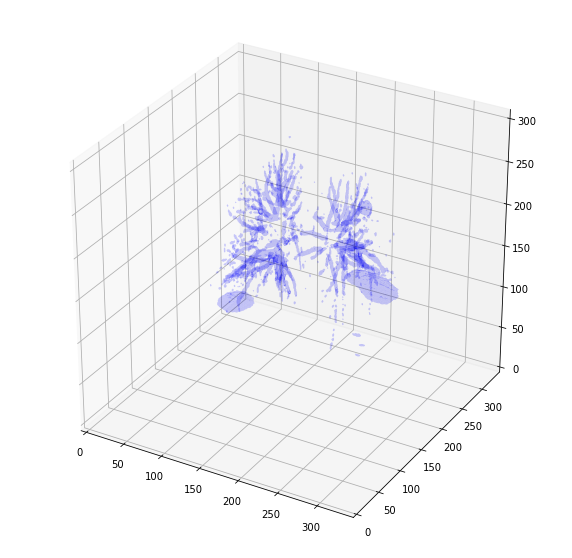

In [180]:
resampled, spacing = resample(first_patient_pixels, first_patient, [1,1,1])
resampled = resampled[::-1]
segmented_lungs = segment_lung_mask(resampled, False)
segmented_lungs_fill = segment_lung_mask(resampled, True)
plot_3d_(segmented_lungs_fill - segmented_lungs, 0, color='blue')


In [191]:
def plot_3d_1(image1, image2, threshold=700, color1="red", color2='blue'):
    
    # Position the scan upright, 
    # so the head of the patient would be at the top facing the camera
    p = image1.transpose(2,1,0)
    p1 = image2.transpose(2,1,0)
    #p1 = p1[::-1]
    
    verts, faces,_,_ = measure.marching_cubes_lewiner(p, 0.3)
    verts1, faces1,_,_ = measure.marching_cubes_lewiner(p1, threshold)

    fig = plt.figure(figsize=(10, 10))
    ax = fig.add_subplot(111, projection='3d')

    # Fancy indexing: `verts[faces]` to generate a collection of triangles
    mesh = Poly3DCollection(verts[faces], alpha=0.2)
    mesh.set_facecolor(color1)
    ax.add_collection3d(mesh)
    
    mesh1 = Poly3DCollection(verts1[faces1], alpha=0.1)
    mesh1.set_facecolor(color2)
    ax.add_collection3d(mesh1)

    ax.set_xlim(0, p.shape[0])
    ax.set_ylim(0, p.shape[1])
    ax.set_zlim(0, p.shape[2])
    plt.savefig('./images/p4_3D', dpi=300)
    plt.show()
    


(76, 256, 256)
(304, 338, 338)
(304, 338, 338)
[4.         0.66015625 0.66015625]


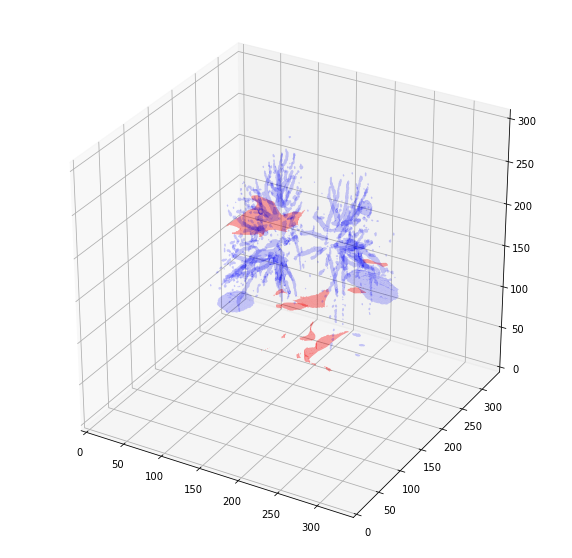

In [192]:
print(CT.shape)
print(img_resampled.shape)
print(segmented_lungs_fill.shape)
CT_1 = np.zeros((len(patients),512,512))
for i in range(CT.shape[0]):
    CT_1[i] = cv2.resize(CT[i],(512,512), interpolation=cv2.INTER_CUBIC)
    
    
img_resampled, spacing = resample(CT_1, first_patient, [1,1,1])

plot_3d_1(img_resampled, segmented_lungs_fill - segmented_lungs, 0)

